In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
from retinaface import RetinaFace
from tensorflow import expand_dims
import joblib
import PIL.Image
import PIL.ImageDraw
import PIL.ImageFont

# Import Data

In [2]:
resp = RetinaFace.detect_faces( "../raw_data/foto_vel.jpg",
                               allow_upscaling = False)

In [3]:
scores = []
faces_area = []
for inner_dict in resp.values():
    scores.append(inner_dict.get('score'))
    faces_area.append(inner_dict.get('facial_area'))


In [4]:
face_rect = faces_area[0]

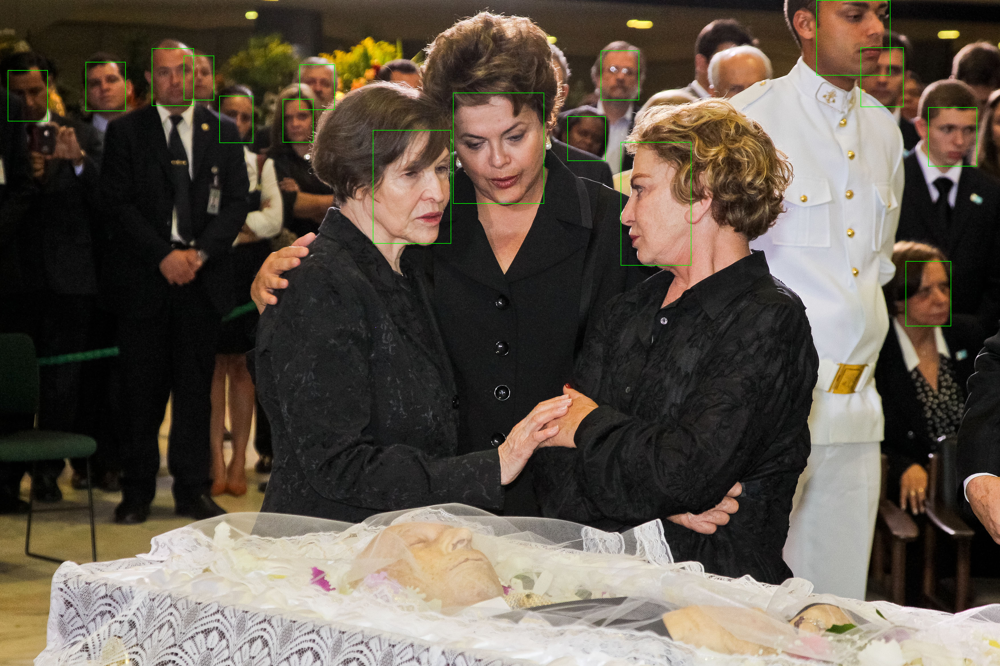

In [5]:
image = PIL.Image.open("../raw_data/foto_vel.jpg")
image_to_draw = PIL.ImageDraw.Draw(image)

for face_rect in faces_area:
    image_to_draw.rectangle(face_rect,outline="#00ff00",width=2)

image

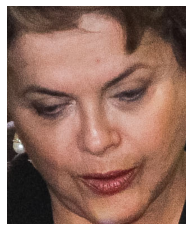

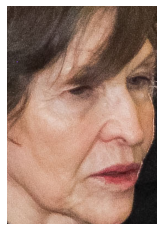

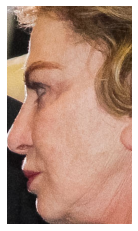

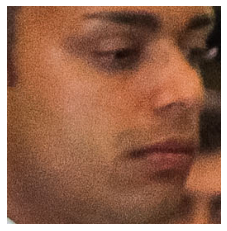

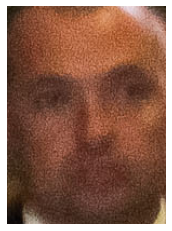

...

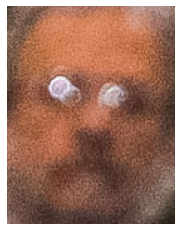

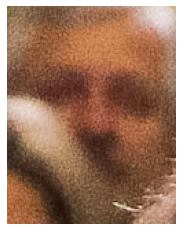

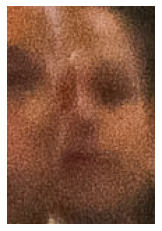

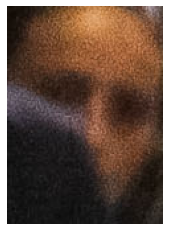

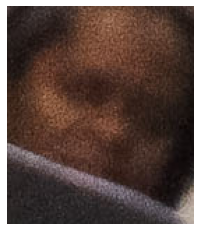

In [6]:
faces = RetinaFace.extract_faces(img_path = "../raw_data/foto_vel.jpg", 
                                 align = False)
for face in faces:
  plt.imshow(face)
  plt.axis('off')
  plt.show()

In [7]:
emotion_map = {0: 'Angry', 1: 'Digust', 2: 'Fear',
                   3: 'Happy', 4: 'Sad', 5: 'Surprise', 6: 'Neutral'}


In [8]:
data = np.zeros(shape=(len(faces), 48, 48), dtype = 'float64')

data.shape

(16, 48, 48)

In [9]:
for i, face in enumerate(faces):
    face_bw = np.array(PIL.Image.fromarray(faces[i])
               .convert("L")
               .resize((48, 48), PIL.Image.ANTIALIAS))
    data[i]=face_bw
    

In [10]:
data = (data/255) -0.5

In [11]:
data = expand_dims(data, axis=-1)
data.shape

TensorShape([16, 48, 48, 1])

In [12]:
model = joblib.load('../model.joblib')
results = model.predict(data)

In [13]:
results.shape

(16, 7)

In [14]:
results.argmax(axis = 1)

array([4, 4, 4, 4, 6, 4, 4, 0, 6, 4, 4, 3, 3, 4, 4, 4])

In [15]:
emotion_results = np.vectorize(emotion_map.get)(results.argmax(axis = 1))

In [16]:
np.mean(results,axis=0)

array([0.17811202, 0.00655485, 0.14424689, 0.1351046 , 0.32760894,
       0.02720595, 0.18116677], dtype=float32)

In [17]:
emotion_df = pd.DataFrame(data={'Emotion': emotion_map.values(), 
              'Percentage': np.mean(results,axis=0)})

In [18]:
emotion_df = emotion_df.sort_values(by='Percentage',ascending=False)
emotion_df.head(3)

,Emotion,Percentage
4,Sad,0.327609
6,Neutral,0.181167
0,Angry,0.178112


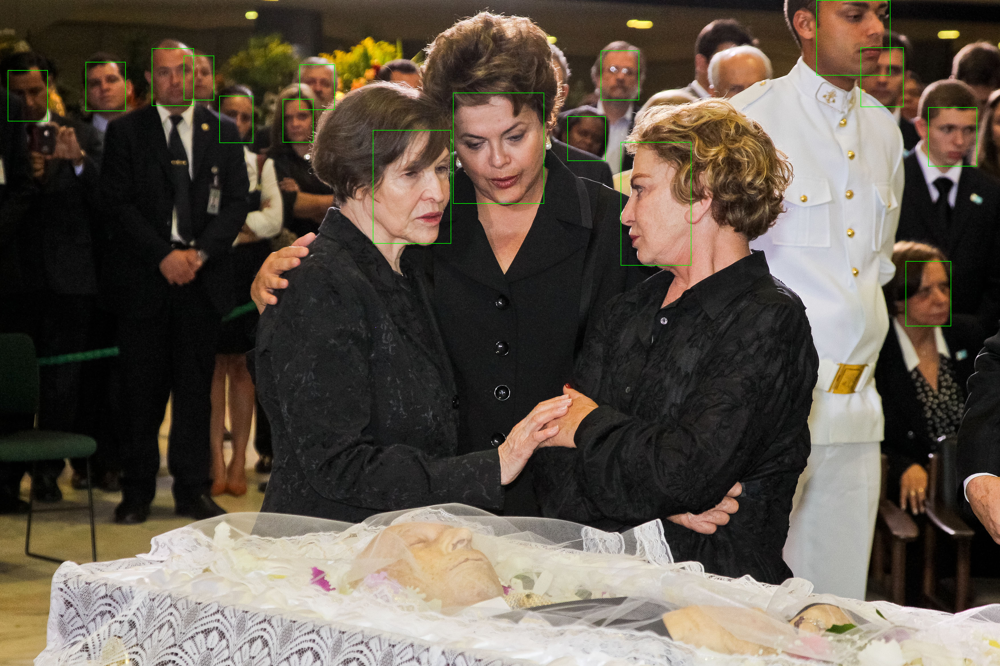

In [19]:
image = PIL.Image.open("../raw_data/foto_vel.jpg")
image_to_draw = PIL.ImageDraw.Draw(image)
font = PIL.ImageFont.load_default()

for i,face_rect in enumerate(faces_area):
    image_to_draw.rectangle(face_rect,outline="#00ff00",width=2)
    ### image_to_draw.text(face_rect[0:2], emotion_results[i])
image

In [20]:
emotion_results[0]

'Sad'